<a href="https://colab.research.google.com/github/may4everL/face_recognition/blob/main/Opencv_projects.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!git clone https://github.com/misbah4064/opencvTutorial.git
%cd opencvTutorial/
from IPython.display import clear_output
clear_output()

#**Change Color Profile**

(476, 640, 3)
(476, 640)
(476, 640, 3)


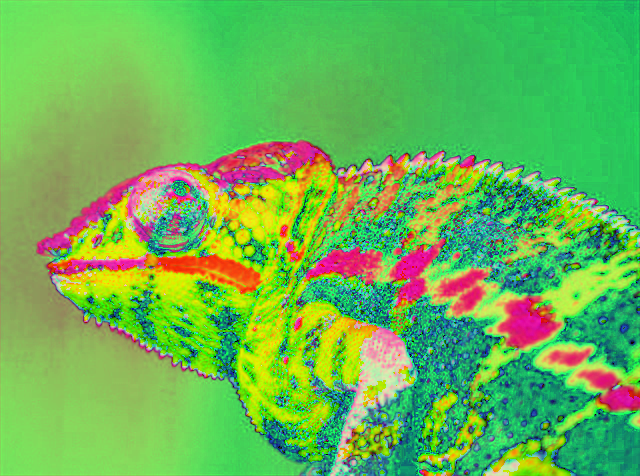

In [7]:
import cv2
from google.colab.patches import cv2_imshow
#colorful image
image = cv2.imread("images/color.jpg")
print(image.shape)#width, height, channel(red, blue, green) of the image

#grayscale image
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)#convert the color of the image
print(gray.shape)#reduce data size of the image

#HSV Image -> hue, saturation, value
hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
print(hsv.shape)#same dimention,while can only use hue to represent every color instead of 3 channels
#cv2_imshow(hsv)

#**Edge Detection**

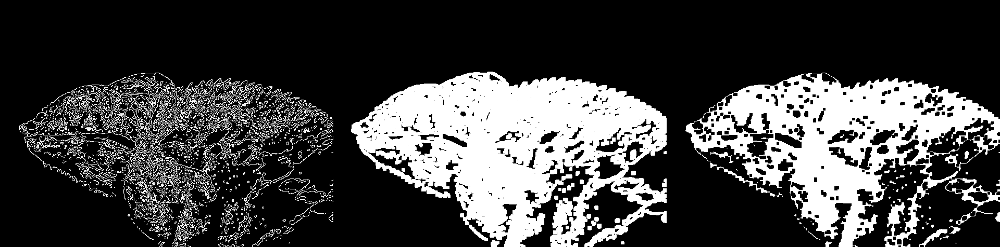

In [18]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

image = cv2.imread("images/color.jpg")
#cv2_imshow(image)
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
canny_image = cv2.Canny(gray, 150, 200)#detecting edges by finding internsity gradient of the image
# cv2_imshow(canny_image)

#Erosion and Dilation
kernel = np.ones((5,5), np.uint8)
#Dilation
dilate_image = cv2.dilate(canny_image, kernel,iterations=1)#edges are epanded
# cv2_imshow(dilate_image)
#Erosion
# kernel = np.ones((1,1), np.uint8)
erode_image = cv2.erode(dilate_image, kernel, iterations=1)#reduce the dilation of the image
# cv2_imshow(erode_image)

display = np.hstack((canny_image, dilate_image, erode_image))
cv2_imshow(display)

#**Image manipulation**

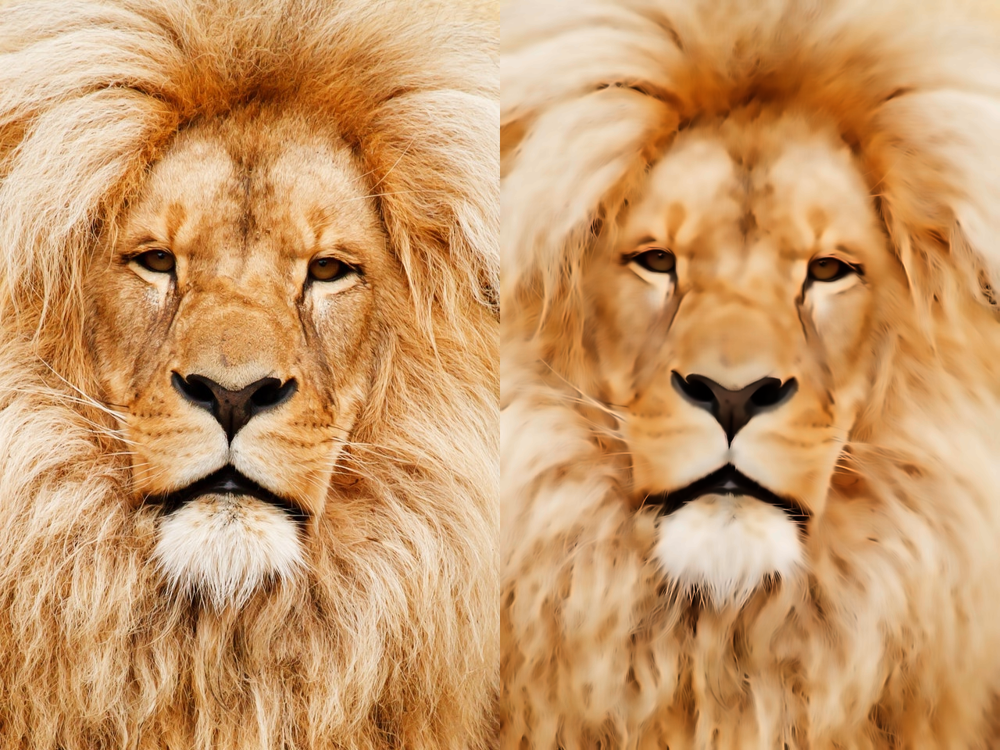

In [21]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

image = cv2.imread("images/lion.jpg")
# cv2_imshow(image)
dst = cv2.fastNlMeansDenoisingColored(image,None, 20, 20, 7, 15)#denoise colored image

display = np.hstack((image, dst))
cv2_imshow(display)

#**Drawing shapes and Writing**

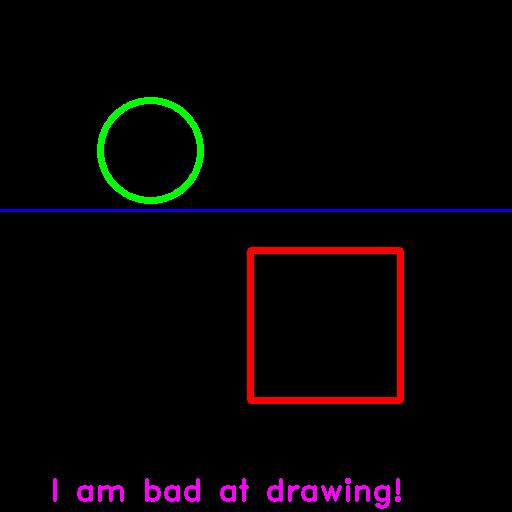

In [31]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = np.zeros((512, 512, 3), np.uint8) #zeroes is black color np.uni8: 0 to 255

#Drawing Functions
cv2.circle(img, (150, 150), 50, (0, 255, 0), 5)
cv2.rectangle(img, (250, 250), (400, 400), (0, 0, 255), 5)
cv2.line(img, (0, 210), (512, 210), (255, 0, 0), 2)
cv2.putText(img, "I am bad at drawing!", (50, 500), cv2.FONT_HERSHEY_DUPLEX, 1, (255, 0, 255), 2)
cv2_imshow(img)

# **Color Detection**

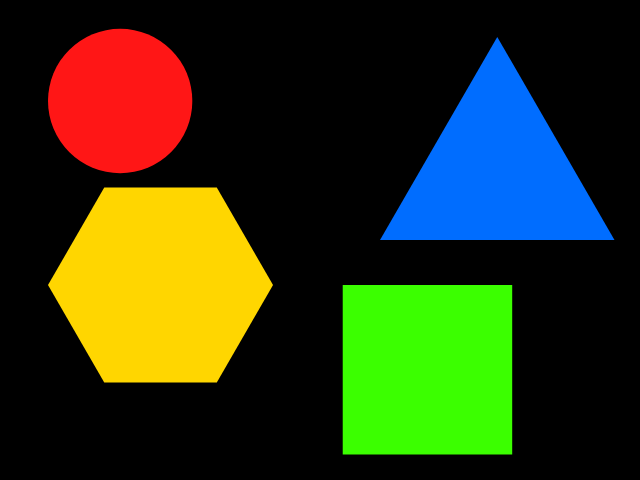

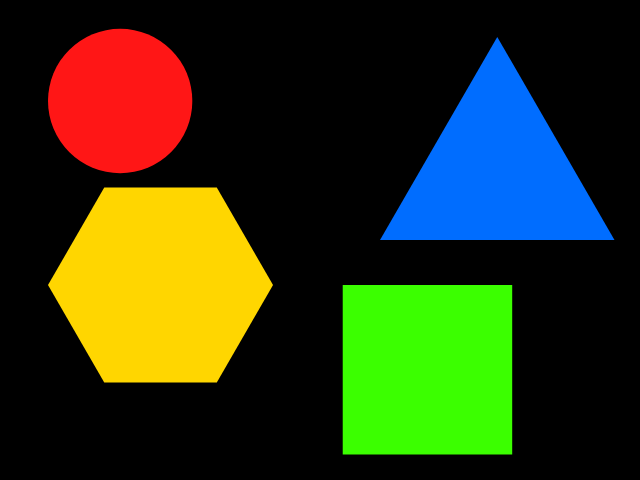

In [43]:
import cv2
from google.colab.patches import cv2_imshow

image = cv2.imread("images/shapes.png")
hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

#filter blue color
# lower_hue = np.array([65, 0, 0])
# upper_hue = np.array([110, 255, 255])#hue bounds for customized blue: 65 to 110

#filter red color
lower_hue = np.array([0, 0, 0])
upper_hue = np.array([20, 255, 255])

#filter green color
# lower_hue = np.array([46, 0, 0])
# upper_hue = np.array([91, 255, 255])

#filter yellow color
# lower_hue = np.array([21, 0, 0])
# upper_hue = np.array([45, 255, 255])

#all colors
lower_hue = np.array([0, 0, 0])
upper_hue = np.array([110, 255, 255])

mask = cv2.inRange(hsv, lower_hue, upper_hue)
# cv2_imshow(mask)
result = cv2.bitwise_and(image, image, mask = mask)
cv2_imshow(result)
cv2_imshow(image)

# **Face Recognition**

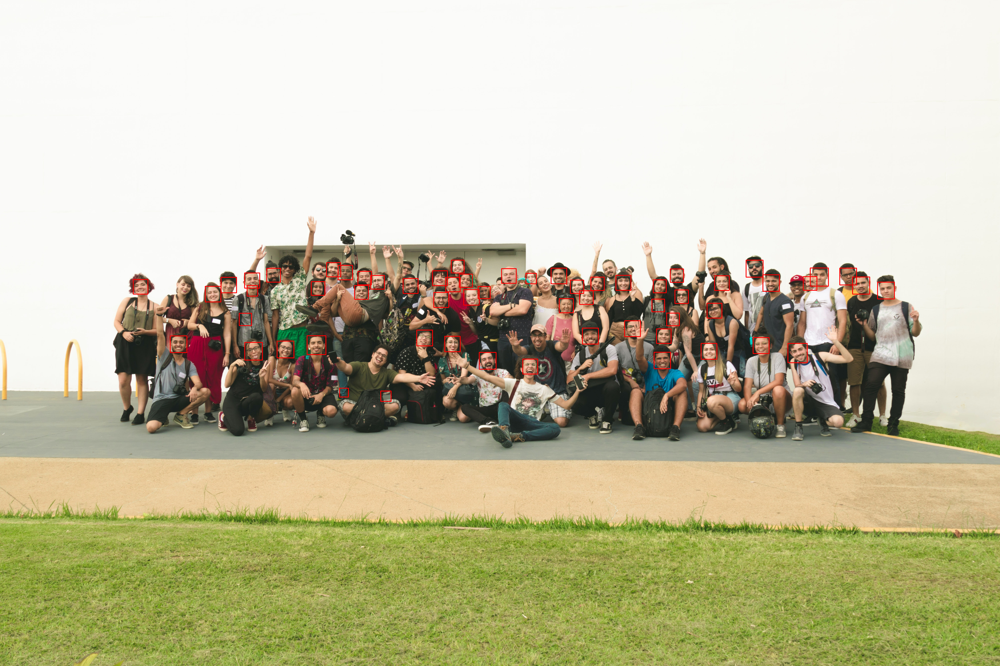

In [49]:
import cv2
from google.colab.patches import cv2_imshow

face_cascade = cv2.CascadeClassifier("files/haarcascade_frontalface_default.xml")
# img = cv2.imread("images/person.jpg")
img = cv2.imread("images/group.jpg")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

#face detection using face_cascade classifier
faces = face_cascade.detectMultiScale(gray, 1.3, 5)
#print(faces)
for (x, y, w, h) in faces:
  cv2.rectangle(img, (x, y), (x+w, y+h), (0, 0, 255), 3)

cv2_imshow(img)

#**Shape detection**

We found a square
We have a hexagon here
We found a triangle
We found a circle
We found a square


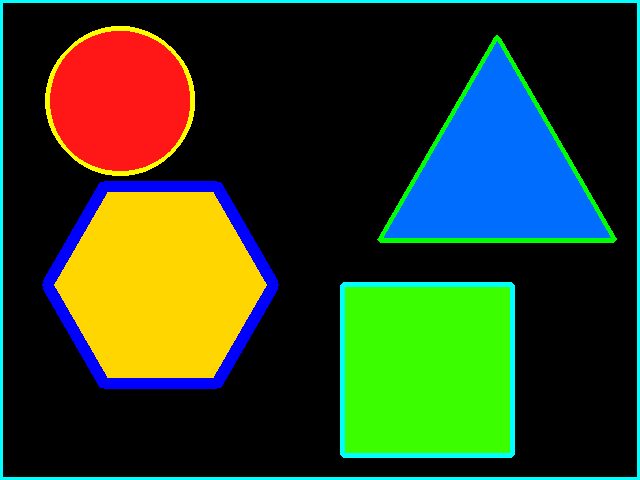

In [60]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread("images/shapes.png")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

ret, thresh = cv2.threshold(gray, 50, 255, 1)
contours, h = cv2.findContours(thresh, 1, 2)

for contour in contours:
  approx = cv2.approxPolyDP(contour, 0.01*cv2.arcLength(contour, True), True)
  n = len(approx)
  if n==6:
    # this is a hexagon
    print("We have a hexagon here")
    cv2.drawContours(img,[contour],0,255,10)
  elif n==3:
    # this is a triangle
    print("We found a triangle")
    cv2.drawContours(img,[contour],0,(0,255,0),3)
  elif n>9:
    # this is a circle
    print("We found a circle")
    cv2.drawContours(img,[contour],0,(0,255,255),3)
  elif n==4:
    # this is a Square
    print("We found a square")
    cv2.drawContours(img,[contour],0,(255,255,0),3)
cv2_imshow(img)

#**Tracking a Ball**

In [64]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

ball = []
cap = cv2.VideoCapture("videos/video.mp4")
output = cv2.VideoWriter('output.avi', cv2.VideoWriter_fourcc('M', 'J', "P", 'G'), 10, (1920, 1080))

while cap.isOpened():
  ret, frame = cap.read()
  if ret is False:
    break
  hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)
  #yellow ball is in the video
  lower_hue = np.array([21, 0, 0])
  upper_hue = np.array([45, 255, 255])
  mask = cv2.inRange(hsv, lower_hue, upper_hue)
  (contours,_) = cv2.findContours(mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

  center = None
  if len(contours)>0:
    c = max(contours, key=cv2.contourArea)
    ((x,y), radius) = cv2.minEnclosingCircle(c)
    M = cv2.moments(c)
    try:
      center = (int(M["m10"]/M["m00"]), int(M["m01"]/M["m00"]))
      cv2.circle(frame, center, 10, (255,0,0), -1)
      ball.append(center)
    except:
      pass
    if len(ball)>2:
      for i in range(1, len(ball)):
        cv2.line(frame, ball[i-1], ball[i], (0, 0, 255), 5)
  output.write(frame)
output.release()

#**Face Recognation**

In [1]:
!git clone https://github.com/misbah4064/face_recognition.git
!pip install face_recognition
%cd face_recognition

Cloning into 'face_recognition'...
remote: Enumerating objects: 26, done.
remote: Counting objects: 100% (26/26), done.
remote: Compressing objects: 100% (24/24), done.
remote: Total 26 (delta 5), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (26/26), done.
     |████████████████████████████████| 100.2MB 117kB/s 
  Created wheel for face-recognition-models: filename=face_recognition_models-0.3.0-py2.py3-none-any.whl size=100566173 sha256=6c9cf7af94df1a7f5c947737f28bdf96d6e76fb569c526198f1d65643ed06733
  Stored in directory: /root/.cache/pip/wheels/d2/99/18/59c6c8f01e39810415c0e63f5bede7d83dfb0ffc039865465f
Successfully built face-recognition-models
/content/face_recognition


##**Create labels for known face images**

In [2]:
import face_recognition
import numpy as np
from google.colab.patches import cv2_imshow
import cv2

# create labels
face_1 = face_recognition.load_image_file("elon.jpg")
face_1_encoding = face_recognition.face_encodings(face_1)[0]

face_2 = face_recognition.load_image_file("Donald Trump.jpg")
face_2_encoding = face_recognition.face_encodings(face_2)[0]

face_3 = face_recognition.load_image_file("jeffbezos.jpg")
face_3_encoding = face_recognition.face_encodings(face_3)[0]

known_face_encodings = [
                        face_1_encoding,
                        face_2_encoding,
                        face_3_encoding
]

known_face_names = [
                    "Elon Musk",
                    "Donald Trump",
                    "Jeff Bezos"
]

#**Recognize faces on unknown images**

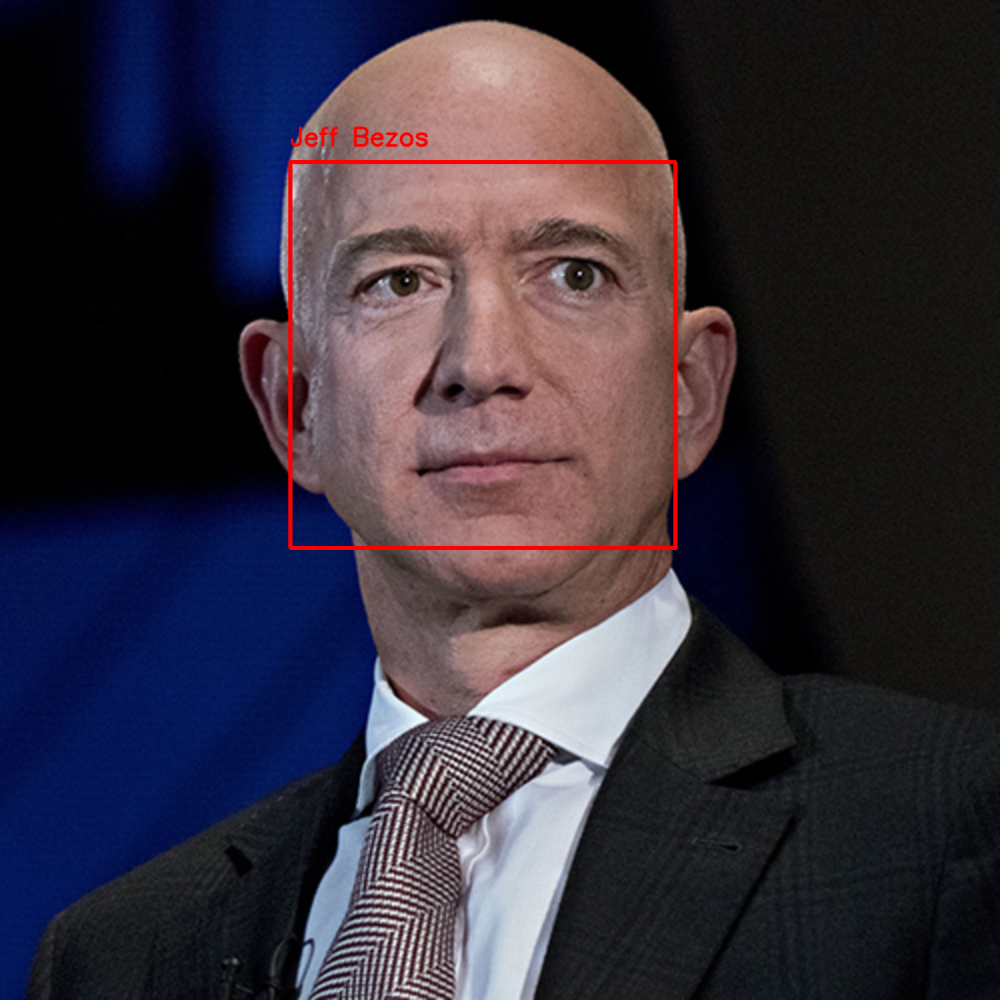

In [9]:
file_name = "unknown_je.jpg"
unknown_image = face_recognition.load_image_file(file_name)
unknown_image_output = cv2.imread(file_name)
face_locations = face_recognition.face_locations(unknown_image)
face_encodings = face_recognition.face_encodings(unknown_image, face_locations)

for (top, right, bottom, left), face_encoding in zip(face_locations, face_encodings):
  matches = face_recognition.compare_faces(known_face_encodings, face_encoding)

  name = "Unknown"

  face_distances = face_recognition.face_distance(known_face_encodings, face_encoding)
  best_match_index = np.argmin(face_distances)
  if matches[best_match_index]:
    name = known_face_names[best_match_index]
  cv2.rectangle(unknown_image_output, (left, top), (right, bottom), (0, 0, 255), 3)
  cv2.putText(unknown_image_output,name, (left, top-20), cv2.FONT_HERSHEY_SIMPLEX,1,(0,0,255),2, cv2.LINE_AA)
cv2_imshow(unknown_image_output)